In [1]:
import pandas as pd
from ydata_profiling import ProfileReport

# Load the data
df1 = pd.read_csv('covid_19_clean_complete.csv')
print(df1.head())

  Province/State Country/Region       Lat       Long        Date  Confirmed  \
0            NaN    Afghanistan  33.93911  67.709953  2020-01-22          0   
1            NaN        Albania  41.15330  20.168300  2020-01-22          0   
2            NaN        Algeria  28.03390   1.659600  2020-01-22          0   
3            NaN        Andorra  42.50630   1.521800  2020-01-22          0   
4            NaN         Angola -11.20270  17.873900  2020-01-22          0   

   Deaths  Recovered  Active             WHO Region  
0       0          0       0  Eastern Mediterranean  
1       0          0       0                 Europe  
2       0          0       0                 Africa  
3       0          0       0                 Europe  
4       0          0       0                 Africa  


In [2]:
# Load the economy data
df2 = pd.read_csv('economy_data.csv')
print(df2.head())

  Country_Code Country_Name        Date  Human_Development_Index  Total_Cases  \
0          AFG  Afghanistan  2019-12-31                    0.498          0.0   
1          AFG  Afghanistan  2020-01-01                    0.498          0.0   
2          AFG  Afghanistan  2020-01-02                    0.498          0.0   
3          AFG  Afghanistan  2020-01-03                    0.498          0.0   
4          AFG  Afghanistan  2020-01-04                    0.498          0.0   

   Total_Deaths  Stringency_Index  Population  GDP_Per_Capita  
0           0.0               0.0   17.477233        7.497754  
1           0.0               0.0   17.477233        7.497754  
2           0.0               0.0   17.477233        7.497754  
3           0.0               0.0   17.477233        7.497754  
4           0.0               0.0   17.477233        7.497754  


In [3]:
profile1 = ProfileReport(df1)
profile1

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
profile2 = ProfileReport(df2)
profile2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
# Convertir las columnas de fecha a datetime
df1['Date'] = pd.to_datetime(df1['Date'])
df2['Date'] = pd.to_datetime(df2['Date'])

# Redondear las fechas al intervalo de 5 días más cercano
df1['Date'] = df1['Date'].dt.round('5D')
df2['Date'] = df2['Date'].dt.round('5D')
# Limitar los dataframes a los primeros 1000 registros


# Renombrar la columna 'Country_Name' en df2_limited a 'Country/Region'
df2 = df2.rename(columns={'Country_Name': 'Country/Region'})

# Ahora puedes hacer el merge
df_joined = df1.merge(df2, on=['Date', 'Country/Region'], suffixes=('_df1', '_df2'))

# Eliminar registros duplicados
df_joined = df_joined.drop_duplicates()

df_joined = df_joined.dropna(subset=['Human_Development_Index'])

print(df_joined.tail())



       Province/State Country/Region    Lat     Long       Date  Confirmed  \
203558            NaN        Lesotho -29.61  28.2336 2020-07-27        419   
203560            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203561            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203562            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203563            NaN        Lesotho -29.61  28.2336 2020-07-27        505   

        Deaths  Recovered  Active WHO Region Country_Code  \
203558       9         69     341     Africa          LSO   
203560      12        128     365     Africa          LSO   
203561      12        128     365     Africa          LSO   
203562      12        128     365     Africa          LSO   
203563      12        128     365     Africa          LSO   

        Human_Development_Index  Total_Cases  Total_Deaths  Stringency_Index  \
203558                     0.52     6.224558      2.484907          4.266896   
2035

In [5]:
profileTotal = ProfileReport(df_joined)
profileTotal

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## **Anáisis Exploratorio**

### Descripción de variables

1.  **Province/State** (Cualitativa nominal): Información sobre la provincia o estado.
2.  **Country/Region** (Cualitativa nominal): El país o región.
3.  **Lat** (Cuantitativa continua): Latitud geográfica.
4.  **Long** (Cuantitativa continua): Longitud geográfica.
5.  **Date** (Cualitativa ordinal): Fecha de la observación, puede ser considerada ordinal en el contexto de series temporales.
6.  **Confirmed** (Cuantitativa discreta): Número de casos confirmados.
7.  **Deaths** (Cuantitativa discreta): Número de muertes.
8.  **Recovered** (Cuantitativa discreta): Número de recuperados.
9.  **Active** (Cuantitativa discreta): Número de casos activos.
10.  **WHO Region** (Cualitativa nominal): Región de la OMS.
11.  **Country_Code** (Cualitativa nominal): Código de país.
12.  **Human_Development_Index** (Cuantitativa continua): Índice de Desarrollo Humano.
13.  **Total_Cases** (Cuantitativa discreta): Total de casos, aunque se contabiliza podría ser considerada continua debido a la gran escala de valores.
14.  **Total_Deaths** (Cuantitativa discreta): Total de muertes, similarmente podría ser considerada continua en grandes escalas.
15.  **Stringency_Index** (Cuantitativa continua): Índice de Estrictitud.
16.  **Population** (Cuantitativa continua): Población.
17.  **GDP_Per_Capita** (Cuantitativa continua): PIB per cápita

In [4]:
resumen_numerico = df_joined.describe()
print("Resumen de variables numéricas:")
print(resumen_numerico)

Resumen de variables numéricas:
                 Lat           Long     Confirmed         Deaths  \
count  123305.000000  123305.000000  1.233050e+05  123305.000000   
mean       23.983254      27.327281  2.361534e+04    1259.617655   
std        25.002580      69.073461  9.848544e+04    5417.653534   
min       -51.796300    -135.000000  0.000000e+00       0.000000   
25%         9.145000      -7.092600  1.830000e+02       2.000000   
50%        28.166700      24.966800  1.040000e+03      15.000000   
75%        42.733900      84.250000  8.481000e+03     186.000000   
max        64.963100     178.065000  2.442375e+06   87618.000000   

          Recovered         Active  Human_Development_Index    Total_Cases  \
count  1.233050e+05  123305.000000            123305.000000  123305.000000   
mean   1.292791e+04    9427.807615                 0.764875       8.386655   
std    6.425179e+04   35327.867755                 0.149033       2.880893   
min    0.000000e+00     -14.000000         

In [5]:
from scipy.stats import normaltest
import numpy as np

# Prueba de normalidad para las variables numéricas
print("\nPrueba de normalidad:")
for column in df_joined.select_dtypes(include=[np.number]).columns:
    stat, p = normaltest(df_joined[column].dropna())
    print(f"{column}:")
    print(f"  Estadístico = {stat}, p-valor = {p}")
    if p > 0.05:
        print("  Distribución normal")
    else:
        print("  Distribución no normal")


Prueba de normalidad:
Lat:
  Estadístico = 9987.194045137101, p-valor = 0.0
  Distribución no normal
Long:
  Estadístico = 8416.089140435244, p-valor = 0.0
  Distribución no normal
Confirmed:
  Estadístico = 212819.7482669746, p-valor = 0.0
  Distribución no normal
Deaths:
  Estadístico = 156856.91499244655, p-valor = 0.0
  Distribución no normal
Recovered:
  Estadístico = 227459.77127840143, p-valor = 0.0
  Distribución no normal
Active:
  Estadístico = 173816.33675585035, p-valor = 0.0
  Distribución no normal
Human_Development_Index:
  Estadístico = 23673.3759613801, p-valor = 0.0
  Distribución no normal
Total_Cases:
  Estadístico = 7366.241339933401, p-valor = 0.0
  Distribución no normal
Total_Deaths:
  Estadístico = 48570.08335591895, p-valor = 0.0
  Distribución no normal
Stringency_Index:
  Estadístico = 85787.28935780737, p-valor = 0.0
  Distribución no normal
Population:
  Estadístico = 1097.6906796248047, p-valor = 4.3601105527487675e-239
  Distribución no normal
GDP_Per_C

In [6]:
# Tablas de frecuencia para las variables categóricas
print("\nTablas de frecuencia para variables categóricas:")
for column in df_joined.select_dtypes(include=['object']).columns:
    print(f"\nFrecuencia de {column}:")
    print(df_joined[column].value_counts())


Tablas de frecuencia para variables categóricas:

Frecuencia de Province/State:
Hong Kong                    875
Shanghai                     848
Guangdong                    834
Beijing                      810
Ontario                      764
                            ... 
Tibet                        198
Saint Barthelemy             193
Anguilla                     189
Northwest Territories        176
Saint Pierre and Miquelon    172
Name: Province/State, Length: 77, dtype: int64

Frecuencia de Country/Region:
China                    17004
Canada                    5714
France                    4319
Australia                 4234
United Kingdom            4218
                         ...  
Seychelles                  78
Saint Lucia                 68
Dominica                    65
Saint Kitts and Nevis       61
Grenada                     60
Name: Country/Region, Length: 170, dtype: int64

Frecuencia de WHO Region:
Europe                   41197
Western Pacific          27249


## Despliegue de Gráficos de Variables

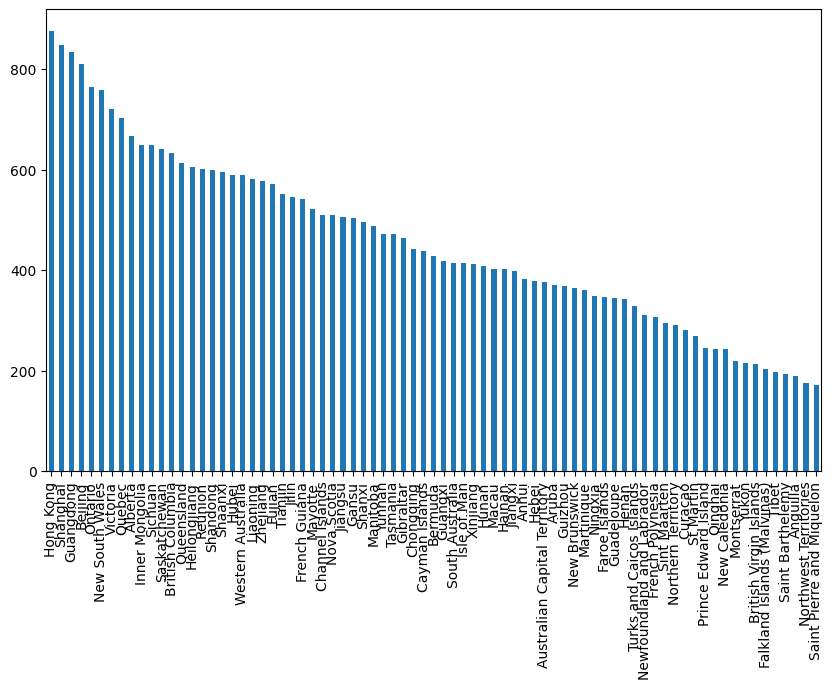

In [7]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
df_joined['Province/State'].value_counts().plot(kind='bar')
plt.show()

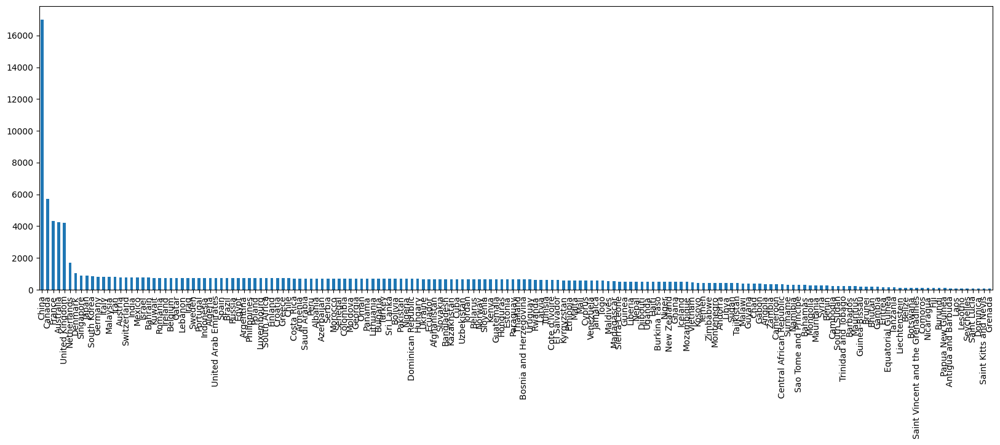

In [8]:
plt.figure(figsize=(20, 6))
df_joined['Country/Region'].value_counts().plot(kind='bar')
plt.show()

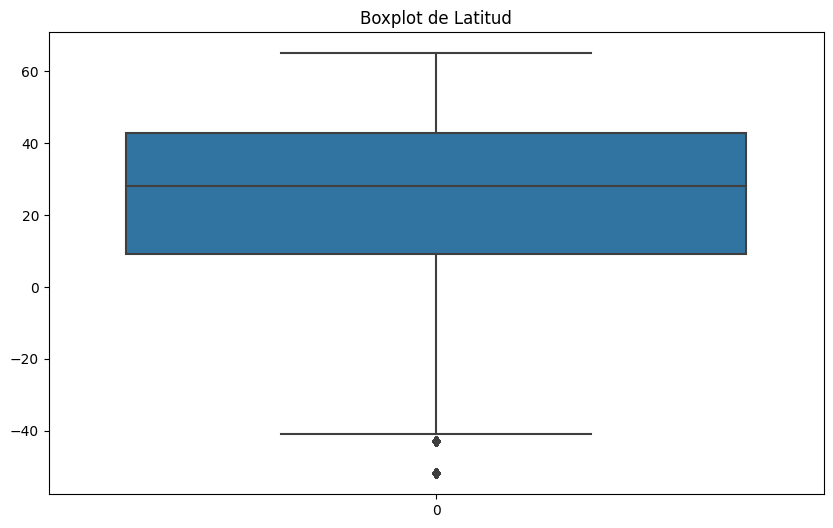

In [9]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Lat'])
plt.title('Boxplot de Latitud')
plt.show()

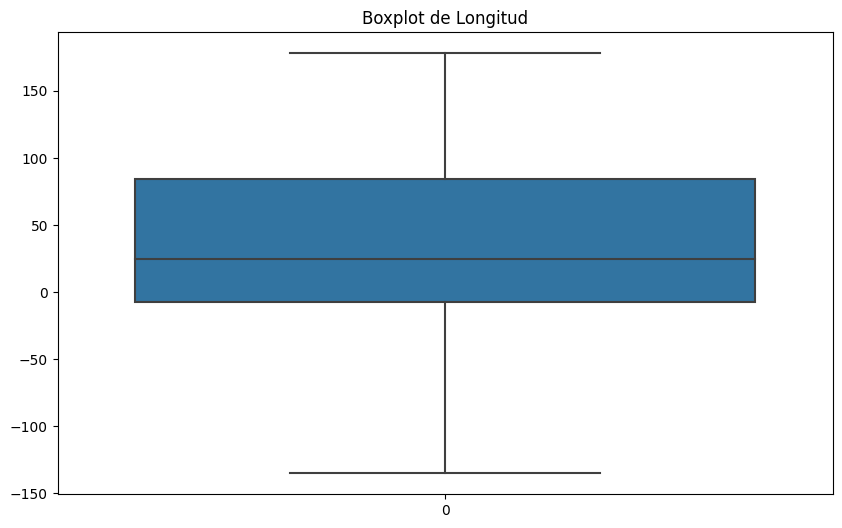

In [10]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Long'])
plt.title('Boxplot de Longitud')
plt.show()

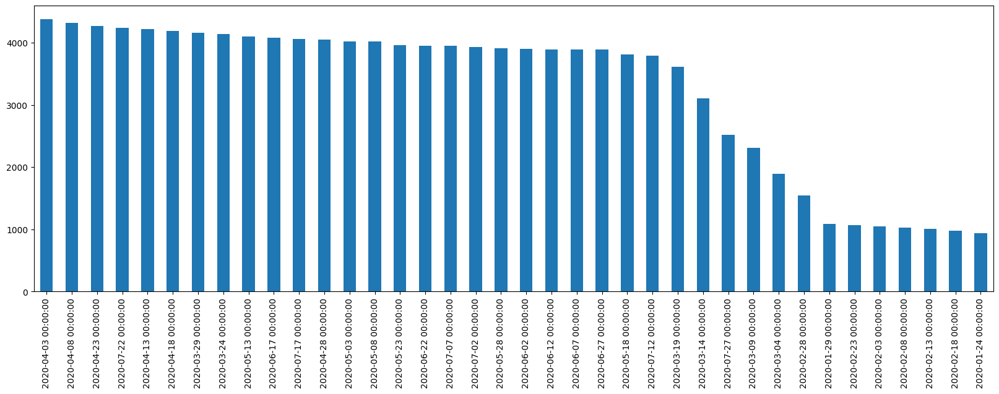

In [11]:
plt.figure(figsize=(20, 6))
df_joined['Date'].value_counts().plot(kind='bar')
plt.show()

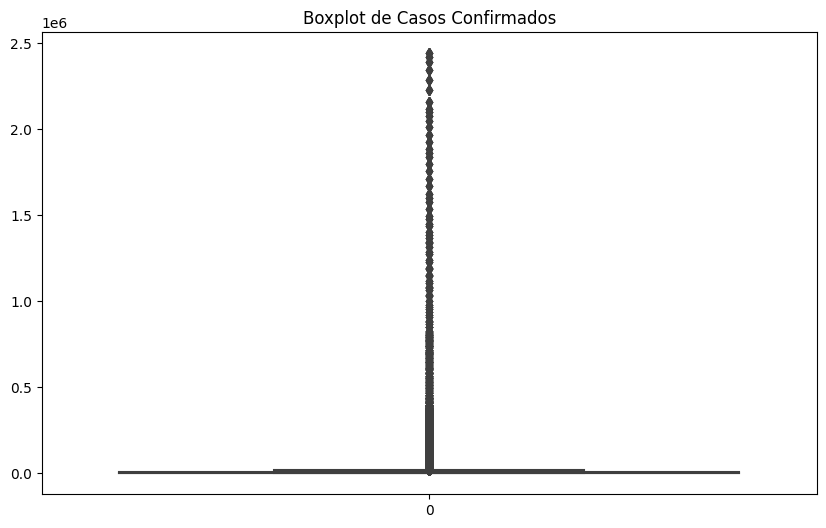

In [12]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Confirmed'])
plt.title('Boxplot de Casos Confirmados')
plt.show()

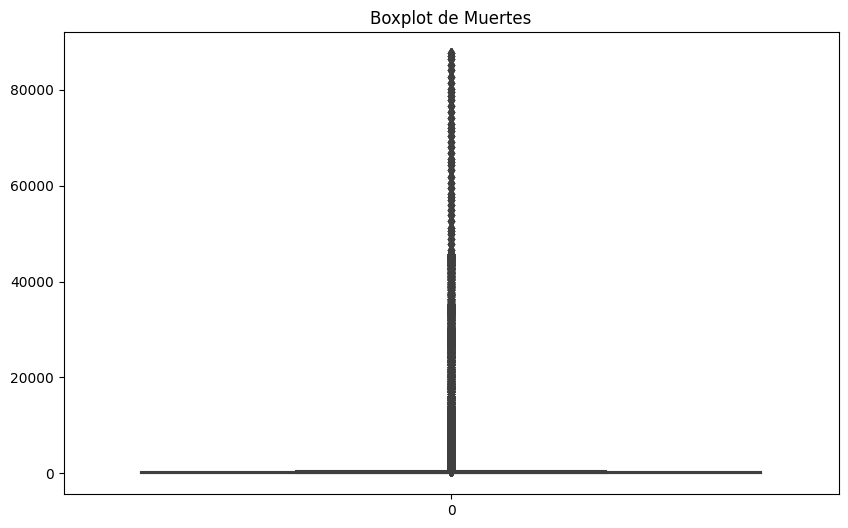

In [13]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Deaths'])
plt.title('Boxplot de Muertes')
plt.show()

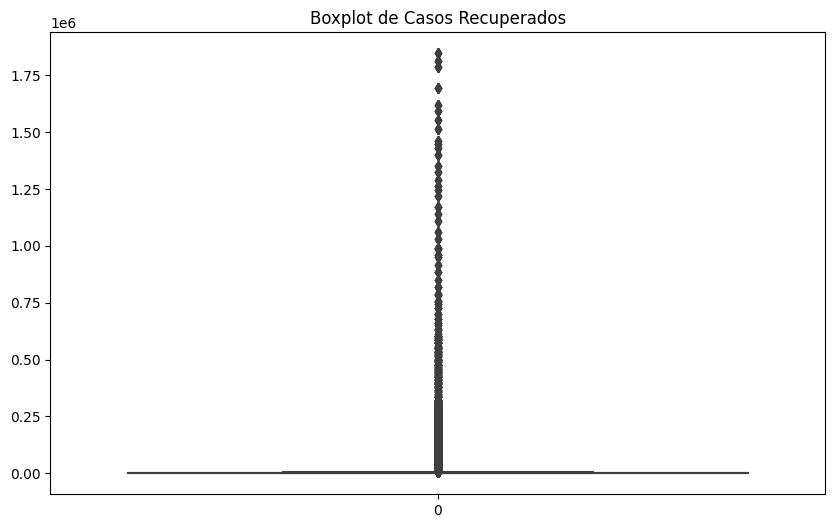

In [14]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Recovered'])
plt.title('Boxplot de Casos Recuperados')
plt.show()

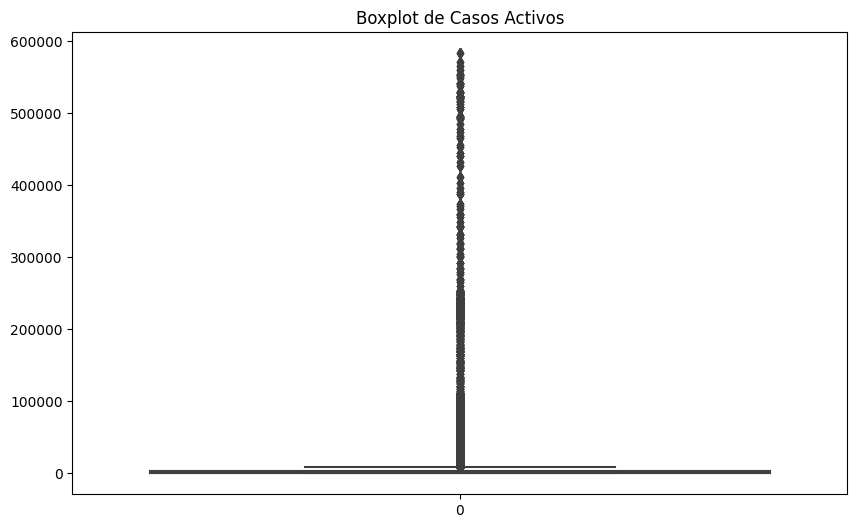

In [15]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Active'])
plt.title('Boxplot de Casos Activos')
plt.show()

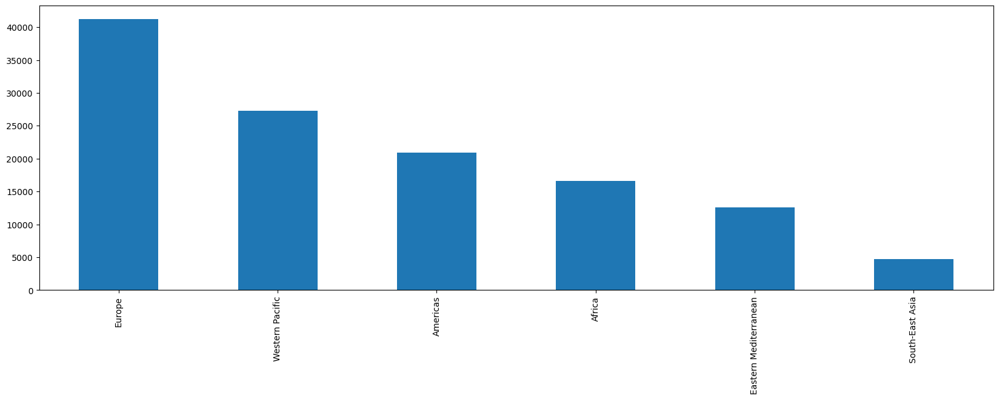

In [16]:
plt.figure(figsize=(20, 6))
df_joined['WHO Region'].value_counts().plot(kind='bar')
plt.show()

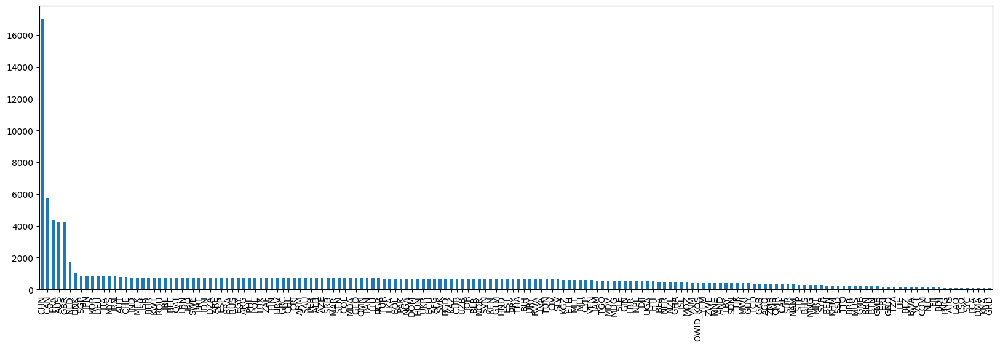

In [17]:
plt.figure(figsize=(20, 6))
df_joined['Country_Code'].value_counts().plot(kind='bar')
plt.show()

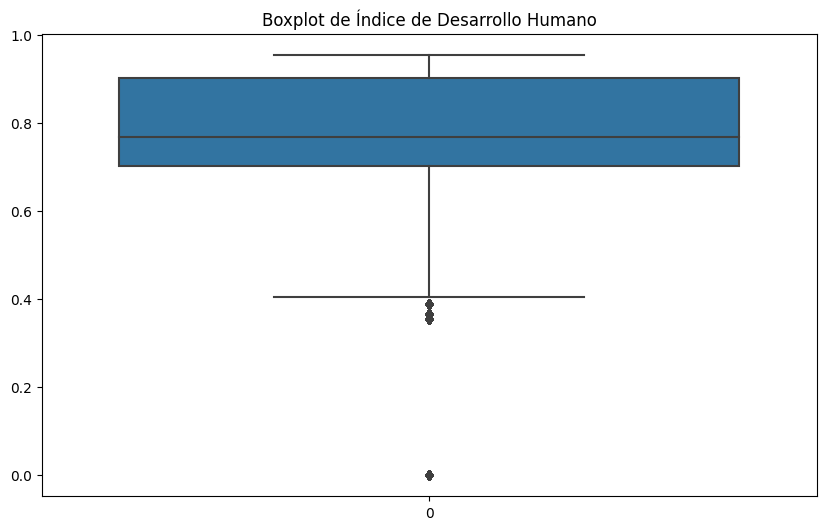

In [18]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Human_Development_Index'])
plt.title('Boxplot de Índice de Desarrollo Humano')
plt.show()

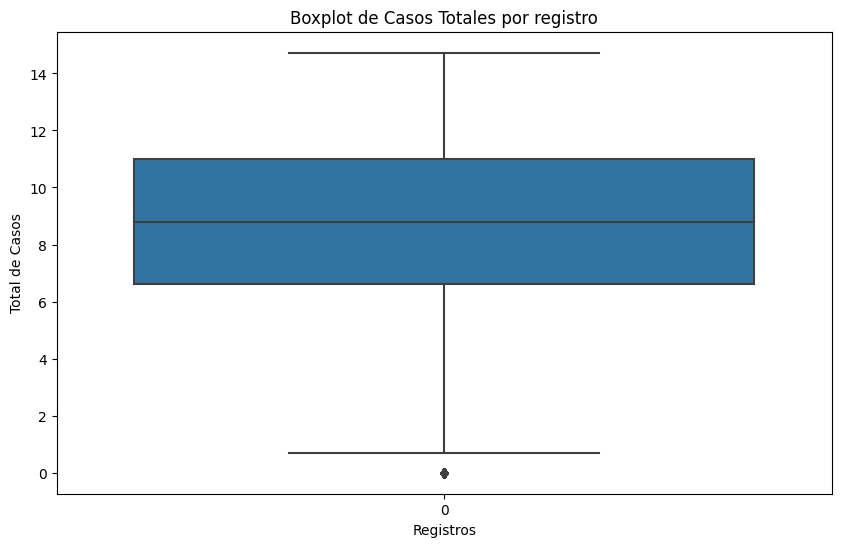

In [30]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Total_Cases'])
plt.title('Boxplot de Casos Totales por registro')
plt.xlabel('Registros')
plt.ylabel('Total de Casos')
plt.show()

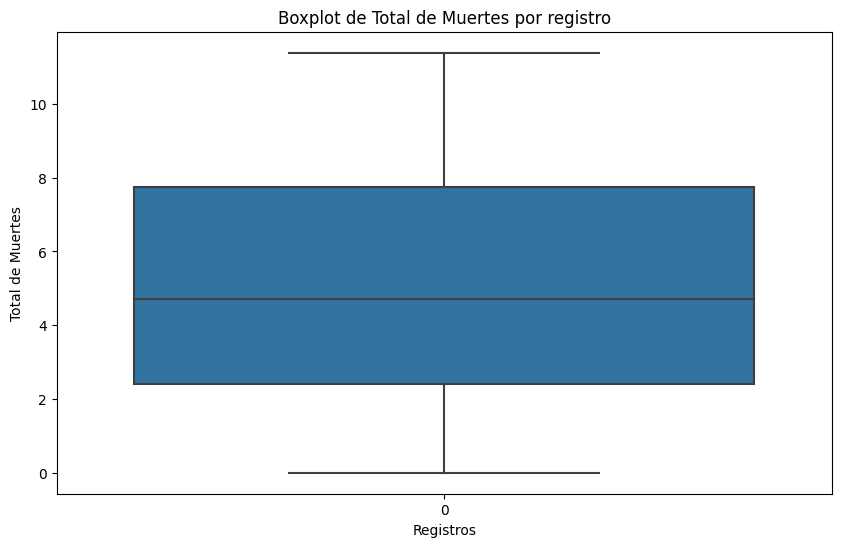

In [31]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Total_Deaths'])
plt.title('Boxplot de Total de Muertes por registro')
plt.xlabel('Registros')
plt.ylabel('Total de Muertes')
plt.show()

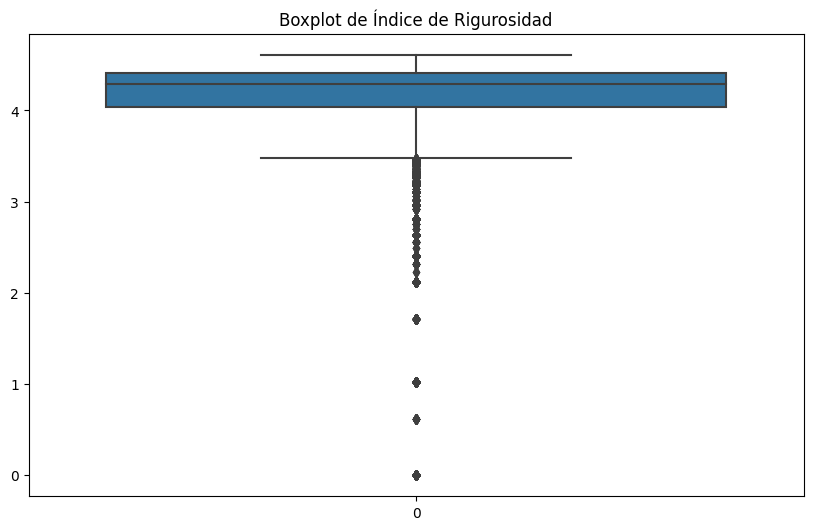

In [21]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Stringency_Index'])
plt.title('Boxplot de Índice de Rigurosidad')
plt.show()

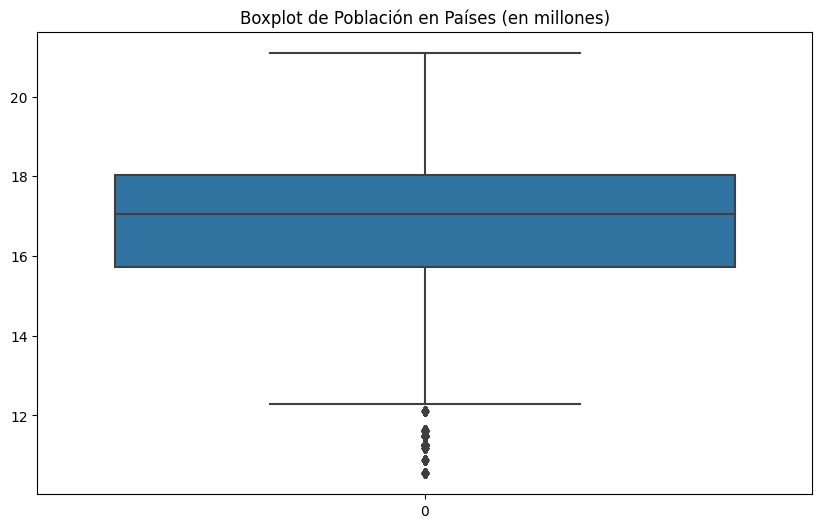

In [22]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Population'])
plt.title('Boxplot de Población en Países (en millones)')
plt.show()

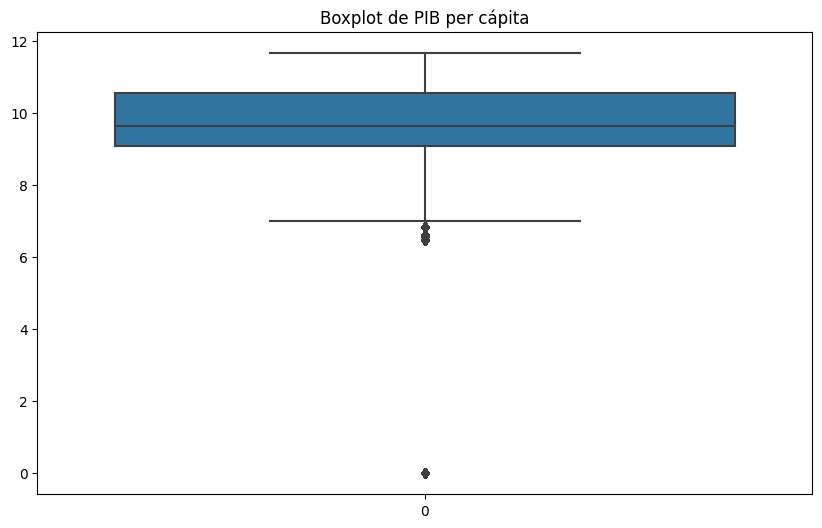

In [23]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['GDP_Per_Capita'])
plt.title('Boxplot de PIB per cápita')
plt.show()

### Elección de Variables para el Análisis


1.  **Confirmed Cases (Casos confirmados)**: Esta variable es fundamental para entender la severidad y la expansión de la pandemia en diferentes regiones y países.
2.  **GDP_Per_Capita (PIB per cápita)**: Indicador económico clave para mostrar cómo las variaciones en la economía de un país están relacionadas con la pandemia.
3.  **Human_Development_Index (Índice de Desarrollo Humano - IDH)**: Este índice combina indicadores de salud, educación y nivel de vida, proporcionando una medida compuesta que puede correlacionarse con la resiliencia de un país frente a la pandemia.
4.  **Total_Deaths (Total de muertes)**: Para evaluar el impacto directo en términos de mortalidad por COVID-19.

Estas variables permiten explorar tanto el impacto directo de la pandemia (a través de casos confirmados y muertes) como las posibles consecuencias económicas y sociales (mediante el PIB per cápita y el IDH). Al cruzar estos datos, podríamos descubrir patrones o correlaciones que sugieran cómo la severidad de la pandemia afecta a diferentes aspectos de un país, o viceversa, cómo ciertas condiciones preexistentes en un país pueden influir en su capacidad para manejar la pandemia.

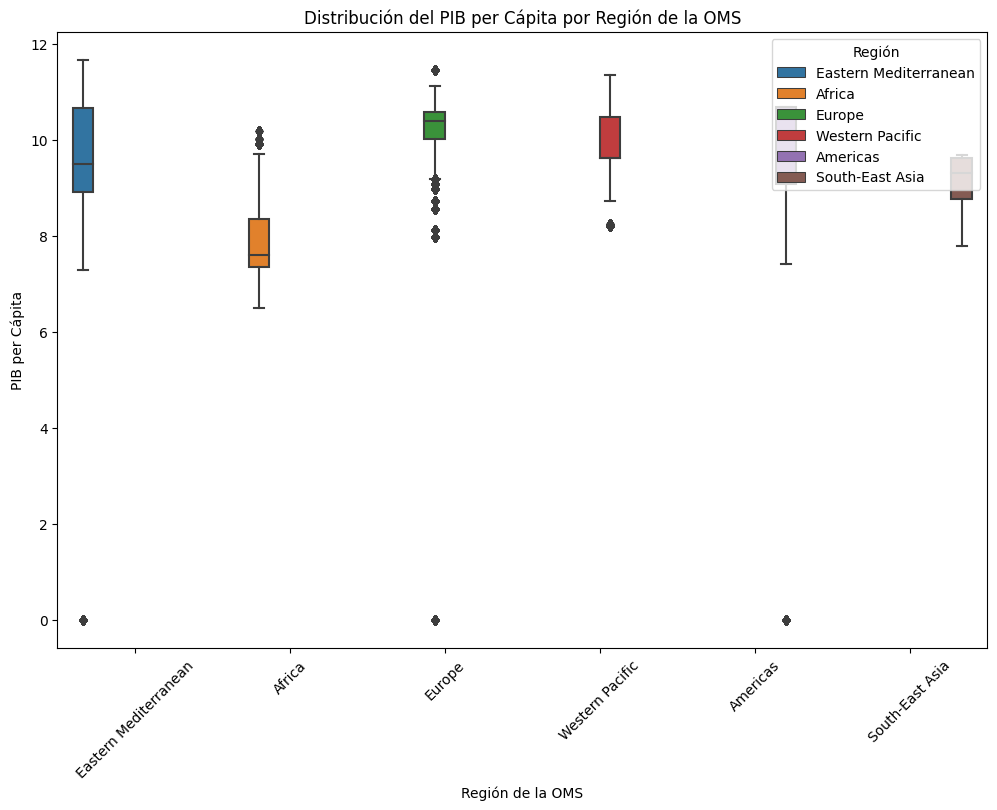

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

plt.figure(figsize=(12, 8)) 
sns.boxplot(data=df_joined, x='WHO Region', y='GDP_Per_Capita', hue='WHO Region')
plt.title('Distribución del PIB per Cápita por Región de la OMS')
plt.xlabel('Región de la OMS')
plt.ylabel('PIB per Cápita')
plt.xticks(rotation=45)
plt.legend(title='Región', loc='upper right') 
plt.show()


In [25]:
# Eliminar filas donde las variables críticas tienen valores faltantes
df_joined.dropna(subset=['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index'], inplace=True)


from sklearn.preprocessing import StandardScaler

# Seleccionar solo las variables numéricas para la normalización
variables_numericas = df_joined[['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index']]
scaler = StandardScaler()
variables_normalizadas = scaler.fit_transform(variables_numericas)

# Reemplazar las columnas originales en el DataFrame por las normalizadas
df_joined[['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index']] = variables_normalizadas


# Codifica variables categóricas
df_encoded = pd.get_dummies(df_joined, columns=['Province/State', 'Country/Region', 'WHO Region'])




In [17]:
df_encoded

,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,Country_Code,Human_Development_Index,Total_Cases,...,Country/Region_Vietnam,Country/Region_Yemen,Country/Region_Zambia,Country/Region_Zimbabwe,WHO Region_Africa,WHO Region_Americas,WHO Region_Eastern Mediterranean,WHO Region_Europe,WHO Region_South-East Asia,WHO Region_Western Pacific
0,33.93911,67.709953,2020-01-24,-0.239786,-0.232503,-0.201208,0,AFG,-1.790713,0.000000,...,0,0,0,0,0,0,1,0,0,0
25,28.03390,1.659600,2020-01-24,-0.239786,-0.232503,-0.201208,0,DZA,-0.072970,0.000000,...,0,0,0,0,1,0,0,0,0,0
50,40.06910,45.038200,2020-01-24,-0.239786,-0.232503,-0.201208,0,ARM,-0.066260,0.000000,...,0,0,0,0,0,0,0,1,0,0
75,-35.47350,149.012400,2020-01-24,-0.239786,-0.232503,-0.201208,0,AUS,1.168368,0.000000,...,0,0,0,0,0,0,0,0,0,1
78,-35.47350,149.012400,2020-01-24,-0.239786,-0.232503,-0.201208,0,AUS,1.168368,0.000000,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203558,-29.61000,28.233600,2020-07-27,-0.235532,-0.230842,-0.200134,341,LSO,-1.643095,6.224558,...,0,0,0,0,1,0,0,0,0,0
203560,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,5.883322,...,0,0,0,0,1,0,0,0,0,0
203561,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,6.037871,...,0,0,0,0,1,0,0,0,0,0
203562,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,6.100319,...,0,0,0,0,1,0,0,0,0,0


### Clustering

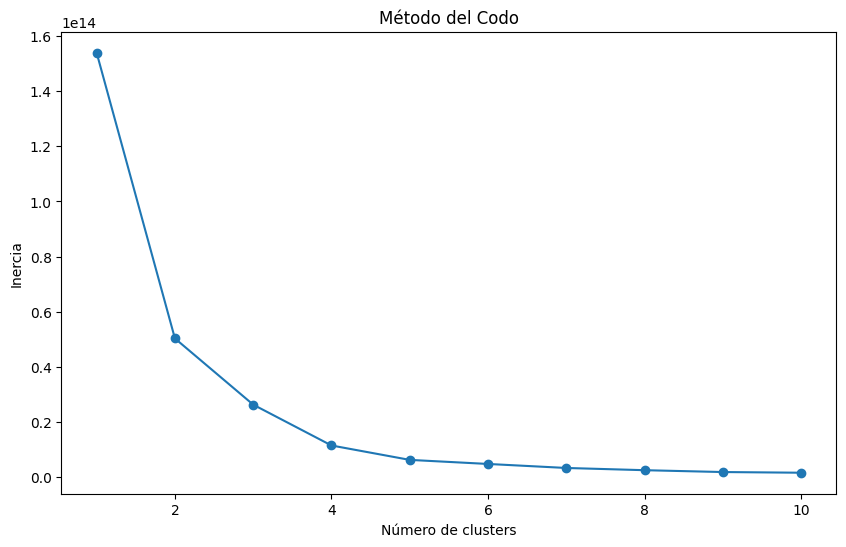

In [26]:
from sklearn.cluster import KMeans

columnas_interes = ['Confirmed', 'Deaths', 'Recovered', 'Active', 'Human_Development_Index',  'GDP_Per_Capita','Total_Cases', 'Total_Deaths']
df_reducido = df_encoded[columnas_interes]

inertias = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_reducido)
    inertias.append(kmeans.inertia_)

# Visualizar el método del codo
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), inertias, marker='o')
plt.title('Método del Codo')
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.show()

In [27]:
n_clusters_optimo = 3 
kmeans = KMeans(n_clusters=n_clusters_optimo, random_state=42)
kmeans.fit(df_reducido)

df_reducido['Cluster'] = kmeans.labels_

C:\Users\pc\AppData\Local\Temp\ipykernel_32760\2490740754.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_reducido['Cluster'] = kmeans.labels_


In [28]:
# Contar el número de observaciones en cada cluster
distribucion_clusters = df_reducido['Cluster'].value_counts()
print("Distribución de los Clusters:")
print(distribucion_clusters)


Distribución de los Clusters:
0    116232
1      5793
2      1280
Name: Cluster, dtype: int64


In [29]:
# Análisis descriptivo para cada cluster
for i in range(n_clusters_optimo):  # Asumiendo n_clusters_optimo es el número de clusters que elegiste
    cluster_data = df_reducido[df_reducido['Cluster'] == i]
    print(f"\nCluster {i}:")
    print(cluster_data[columnas_interes].describe())



Cluster 0:
           Confirmed         Deaths      Recovered         Active  \
count  116232.000000  116232.000000  116232.000000  116232.000000   
mean       -0.138727      -0.146303      -0.103371    3199.628037   
std         0.309036       0.431868       0.387277    6845.856584   
min        -0.239786      -0.232503      -0.201208     -14.000000   
25%        -0.238121      -0.232319      -0.200990      41.000000   
50%        -0.230394      -0.230288      -0.196819     316.000000   
75%        -0.185047      -0.211646      -0.173209    2107.000000   
max         3.292964       6.945541       4.778502   37988.000000   

       Human_Development_Index  GDP_Per_Capita    Total_Cases   Total_Deaths  
count            116232.000000   116232.000000  116232.000000  116232.000000  
mean                 -0.019579       -0.017582       8.167110       4.611532  
std                   1.010489        1.019528       2.814821       3.022932  
min                  -5.132260       -6.385297    

Para realizar el análisis y las predicciones sobre el impacto del COVID-19, dividimos nuestros datos en conjuntos de entrenamiento y prueba. Este proceso es crucial para evaluar el rendimiento de nuestros modelos y asegurarnos de que estos puedan generalizarse a datos no vistos. A continuación, se detalla el método seguido para esta división, el porcentaje de datos en cada conjunto y el análisis de los datos.

Utilizamos la función `train_test_split` de la librería `scikit-learn` para dividir nuestros datos en conjuntos de entrenamiento y prueba. La división se realizó con 80% de datos de entreno y 20% de prueba.


# PImplementación de modelos

In [35]:
# Eliminar la columna 'Country_Code'
df_encoded = df_encoded.drop('Country_Code', axis=1)

# Asegúrate de que la columna 'Date' esté en formato datetime
df_encoded['Date'] = pd.to_datetime(df_encoded['Date'])

# Convertir 'Date' a la cantidad de días desde una fecha específica
df_encoded['Date'] = (df_encoded['Date'] - pd.Timestamp("2020-01-01")).dt.days

### Total Cases y Total Deaths

### Análisis de Valores Atípicos

#### Casos Totales

En el análisis del boxplot de los casos totales, se identificó la presencia de un único valor atípico. Dado que el conjunto de datos contiene aproximadamente 15,000 registros, la influencia de este valor atípico en las métricas estadísticas generales es mínima. Por lo tanto, se ha decidido mantener este valor en el análisis, ya que no tiene un impacto significativo en la interpretación global de los datos.

#### Total de Muertes

En el análisis del boxplot del total de muertes, no se detectaron valores atípicos. Esto sugiere que la distribución de los datos es consistente y no presenta variaciones extremas que podrían distorsionar el análisis. Por lo tanto, no se requieren ajustes adicionales para esta variable.


In [36]:
from sklearn.model_selection import train_test_split

# Definimos las características y las variables objetivo
X = df_encoded.drop(['Total_Cases', 'Total_Deaths'], axis=1)
y_cases = df_encoded['Total_Cases']
y_deaths = df_encoded['Total_Deaths']

# División de los datos en conjuntos de entrenamiento y prueba
X_train_cases, X_test_cases, y_train_cases, y_test_cases = train_test_split(X, y_cases, test_size=0.2, random_state=42)
X_train_deaths, X_test_deaths, y_train_deaths, y_test_deaths = train_test_split(X, y_deaths, test_size=0.2, random_state=42)


In [40]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Configuración del modelo y los hiperparámetros específicos
param_combinations = [
    {'n_estimators': 50, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1},
    {'n_estimators': 100, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 2},
    {'n_estimators': 200, 'max_depth': 30, 'min_samples_split': 10, 'min_samples_leaf': 4}
]

def evaluate_model(X_train, y_train, X_test, y_test, param_combinations):
    best_model = None
    best_score = -float('inf')
    best_params = None
    best_y_pred = None
    
    for params in param_combinations:
        rf = RandomForestRegressor(
            n_estimators=params['n_estimators'],
            max_depth=params['max_depth'],
            min_samples_split=params['min_samples_split'],
            min_samples_leaf=params['min_samples_leaf'],
            random_state=42
        )
        rf.fit(X_train, y_train)
        y_pred = rf.predict(X_test)
        
        mse = mean_squared_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        
        print(f'Parámetros: {params}')
        print(f'MSE: {mse}')
        print(f'R^2: {r2}')
        
        if r2 > best_score:
            best_score = r2
            best_model = rf
            best_params = params
            best_y_pred = y_pred
    
    print(f'\nMejores parámetros: {best_params}')
    print(f'Mejor R^2: {best_score}')
    
    return best_model, best_y_pred

# Evaluar el modelo para Total_cases
print("Evaluación del modelo para Total_cases:")
rf_cases, y_pred_cases = evaluate_model(X_train_cases, y_train_cases, X_test_cases, y_test_cases, param_combinations)

# Evaluar el modelo para Total_deaths
print("Evaluación del modelo para Total_deaths:")
rf_deaths, y_pred_deaths = evaluate_model(X_train_deaths, y_train_deaths, X_test_deaths, y_test_deaths, param_combinations)


Evaluación del modelo para Total_cases:
Parámetros: {'n_estimators': 50, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1}
MSE: 0.0745562084092347
R^2: 0.9910001842039078
Parámetros: {'n_estimators': 100, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 2}
MSE: 0.056409748268978495
R^2: 0.9931906764794405
Parámetros: {'n_estimators': 200, 'max_depth': 30, 'min_samples_split': 10, 'min_samples_leaf': 4}
MSE: 0.05489037585796147
R^2: 0.9933740826922371

Mejores parámetros: {'n_estimators': 200, 'max_depth': 30, 'min_samples_split': 10, 'min_samples_leaf': 4}
Mejor R^2: 0.9933740826922371
Evaluación del modelo para Total_deaths:
Parámetros: {'n_estimators': 50, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1}
MSE: 0.08565997811232051
R^2: 0.9911346453004779
Parámetros: {'n_estimators': 100, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 2}
MSE: 0.022545140708765184
R^2: 0.997666697172491
Parámetros: {'n_estimators': 200, 'max_depth': 


- El análisis de los resultados del modelo Random Forest para Total_cases y Total_deaths muestra que para Total_cases, los mejores parámetros fueron n_estimators de 200, max_depth de 30, min_samples_split de 10, y min_samples_leaf de 4, obteniendo un R2 de 0.9934 y un MSE de 0.549, lo que indica una excelente capacidad de explicación de la variabilidad en los datos con un menor error cuadrático medio. 
- Para Total_deaths, los mejores parámetros fueron n_estimators de 100, max_depth de 20, min_samples_split de 5, y min_samples_leaf de 2, logrando un R2 de 0.9977 y un MSE de 0.0225, sugiriendo que el modelo explica casi toda la variabilidad en los datos con una precisión muy alta. Ambos modelos muestran un ajuste excelente con valores de R2 superiores a 0.99, lo que es indicativo de un ajuste muy bueno

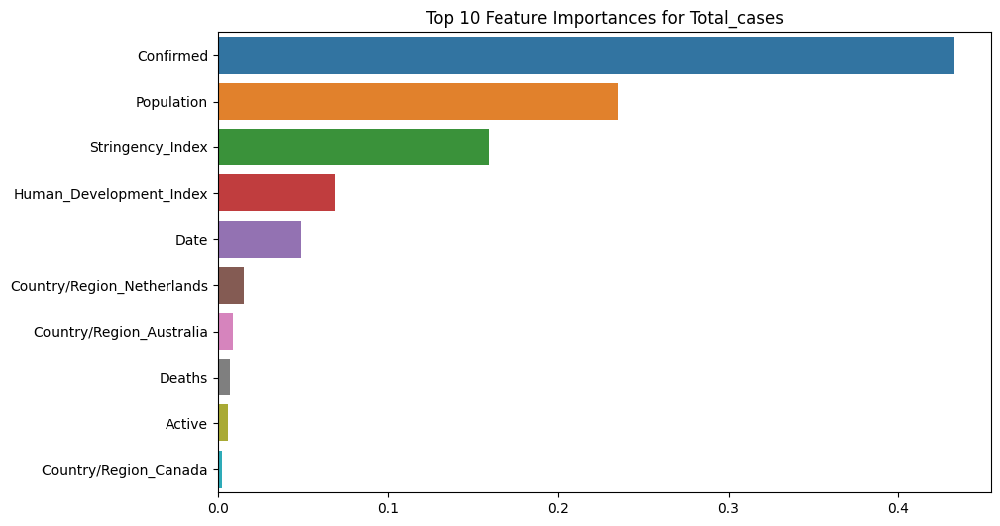

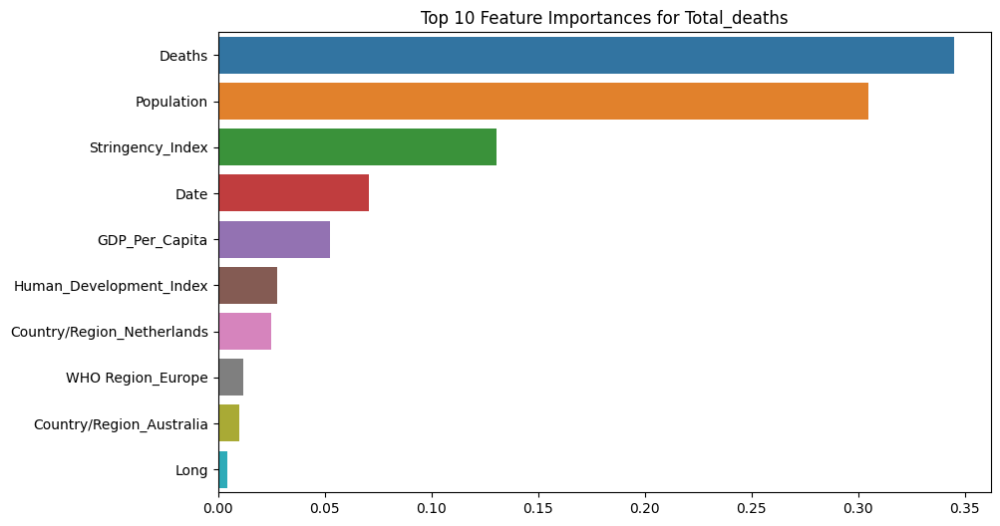

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Importancia de características para Total_cases
importances_cases = rf_cases.feature_importances_
indices_cases = np.argsort(importances_cases)[::-1]
features_cases = X.columns

# Mostrar solo las 10 características más importantes
top_n = 10
top_indices_cases = indices_cases[:top_n]

plt.figure(figsize=(10,6))
sns.barplot(x=importances_cases[top_indices_cases], y=features_cases[top_indices_cases])
plt.title('Top 10 Feature Importances for Total_cases')
plt.show()

# Importancia de características para Total_deaths
importances_deaths = rf_deaths.feature_importances_
indices_deaths = np.argsort(importances_deaths)[::-1]
features_deaths = X.columns

# Mostrar solo las 10 características más importantes
top_indices_deaths = indices_deaths[:top_n]

plt.figure(figsize=(10,6))
sns.barplot(x=importances_deaths[top_indices_deaths], y=features_deaths[top_indices_deaths])
plt.title('Top 10 Feature Importances for Total_deaths')
plt.show()


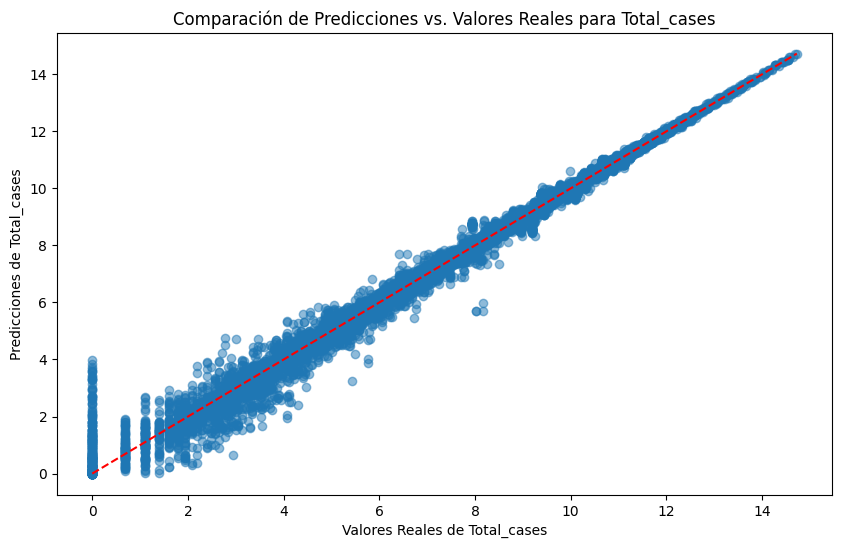

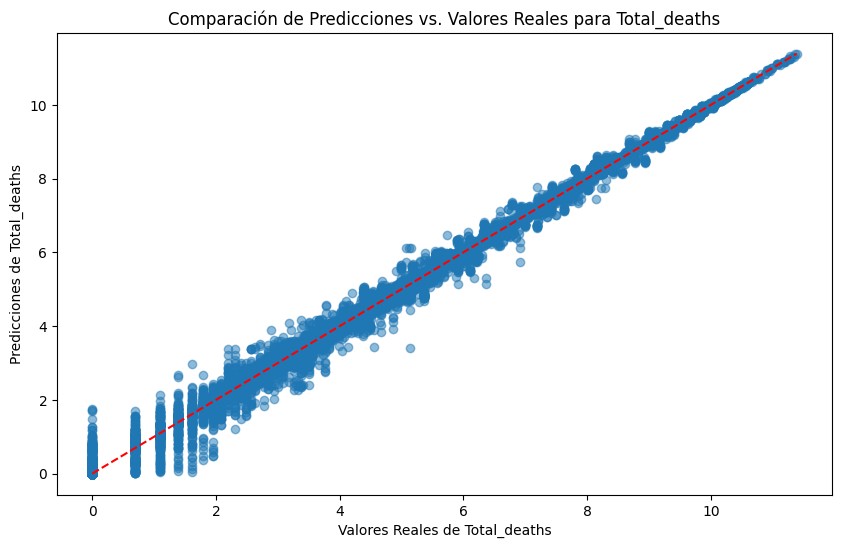

In [42]:

plt.figure(figsize=(10,6))
plt.scatter(y_test_cases, y_pred_cases, alpha=0.5)
plt.plot([y_test_cases.min(), y_test_cases.max()], [y_test_cases.min(), y_test_cases.max()], 'r--')
plt.xlabel('Valores Reales de Total_cases')
plt.ylabel('Predicciones de Total_cases')
plt.title('Comparación de Predicciones vs. Valores Reales para Total_cases')
plt.show()

plt.figure(figsize=(10,6))
plt.scatter(y_test_deaths, y_pred_deaths, alpha=0.5)
plt.plot([y_test_deaths.min(), y_test_deaths.max()], [y_test_deaths.min(), y_test_deaths.max()], 'r--')
plt.xlabel('Valores Reales de Total_deaths')
plt.ylabel('Predicciones de Total_deaths')
plt.title('Comparación de Predicciones vs. Valores Reales para Total_deaths')
plt.show()


### Importancia de las Características para Casos Totales y Muertes Totales de COVID-19

### Total_cases
En la primera gráfica, las características más importantes para el número total de casos (Total_cases) son:

- **Confirmed**: Es la característica más importante con una puntuación de importancia muy alta, lo que indica que el número de casos confirmados tiene la mayor influencia en la predicción de los casos totales.
- **Population**: La población también tiene una gran influencia en la predicción.
- **Stringency_Index**: Este índice, que mide la severidad de las políticas de respuesta al COVID-19, también es un factor significativo.
- **Human_Development_Index**: Este índice, que refleja el nivel de desarrollo humano, tiene una influencia menor pero aún significativa.
- **Date**: La fecha también contribuye a la predicción, aunque con menor importancia que las características anteriores.
- **Country/Region_Netherlands, Country/Region_Australia, Active, Deaths, Country/Region_Canada**: Estas características tienen una importancia relativamente baja en comparación con las demás.

### Total_deaths
En la segunda gráfica, las características más importantes para el número total de muertes (Total_deaths) son:

- **Deaths**: Es la característica más importante con una puntuación de importancia muy alta, lo que indica que el número de muertes tiene la mayor influencia en la predicción de las muertes totales.
- **Population**: La población también tiene una gran influencia en la predicción de las muertes totales.
- **Stringency_Index**: Este índice también es un factor significativo en la predicción.
- **Date**: La fecha tiene una influencia menor pero significativa.
- **GDP_Per_Capita**: El PIB per cápita es también una característica importante.
- **Human_Development_Index, Country/Region_Netherlands, WHO Region_Europe, Country/Region_Australia, Long**: Estas características tienen una importancia relativamente baja en comparación con las demás.

### Conclusiones
- En ambos modelos, las características relacionadas directamente con el COVID-19 (como Confirmed y Deaths) y las demográficas (Population) son las más importantes.
- El **Stringency_Index**, que mide la severidad de las políticas, es una característica importante en ambos casos, lo que sugiere que las medidas de respuesta tienen un impacto significativo tanto en el número de casos como en el número de muertes.
- Características como **Human_Development_Index** y **GDP_Per_Capita** también son relevantes, indicando que el nivel de desarrollo y la riqueza de un país influyen en las predicciones de casos y muertes.
- Las características específicas de los países (como **Country/Region_Netherlands, Country/Region_Australia**) tienen menor importancia en ambos modelos, lo que sugiere que las variables globales y las respuestas políticas tienen un impacto mayor.


### GDP_per_capita

In [26]:

X_gdp = df_encoded.drop(['GDP_Per_Capita'], axis=1)
y_gdp = df_encoded['GDP_Per_Capita']

X_train_gdp, X_test_gdp, y_train_gdp, y_test_gdp = train_test_split(X_gdp, y_gdp, test_size=0.2, random_state=42)

# Entrenamiento del modelo
rf_gdp = RandomForestRegressor(n_estimators=100, random_state=42)
rf_gdp.fit(X_train_gdp, y_train_gdp)

# Realizar predicciones
y_pred_gdp = rf_gdp.predict(X_test_gdp)

# Evaluación del modelo
mse_gdp = mean_squared_error(y_test_gdp, y_pred_gdp)
r2_gdp = r2_score(y_test_gdp, y_pred_gdp)

print(f'GDP_Per_Capita - MSE: {mse_gdp}, R2: {r2_gdp}')


GDP_Per_Capita - MSE: 3.199512280777082e-10, R2: 0.9999999996831012


El MSE es de 
3.199512280777082e-10. Este valor es muy pequeño, lo que indica que los errores entre las predicciones y los valores reales son, en promedio, muy cercanos a cero. Siguriendo que el modelo hace predicciones muy precisas con un error cuadrático medio cercano a cero. El R² es de 0.9999999996831012, indicando que el modelo explica prácticamente toda la variabilidad de los datos de GDP_Per_Capita. 



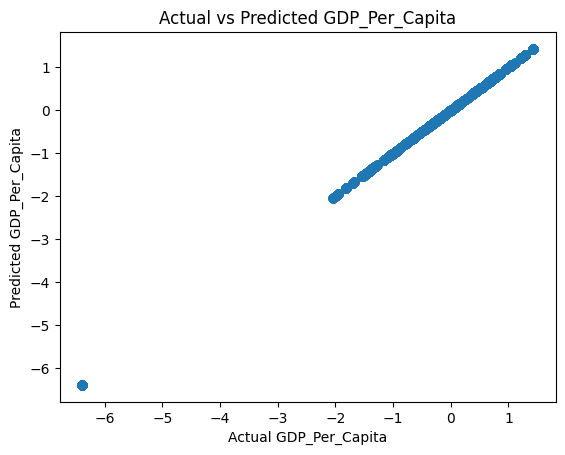

In [27]:
# Visualizar los resultados
plt.scatter(y_test_gdp, y_pred_gdp)
plt.xlabel('Actual GDP_Per_Capita')
plt.ylabel('Predicted GDP_Per_Capita')
plt.title('Actual vs Predicted GDP_Per_Capita')
plt.show()

La relación lineal sigue una línea diagonal, indicando que las predicciones del modelo tienden a aumentar con los valores reales y que existe una correlación lineal fuerte entre las predicciones y los valores reales. Existe un punto que esta alejado dl patrón lineal. Esto podría ser un dato atipico en los datos, 



In [28]:
#Analizando el valor atípico
outlier_analysis = pd.DataFrame({
    'Actual': y_test_gdp,
    'Predicted': y_pred_gdp,
    'Residual': y_test_gdp - y_pred_gdp
})

# Ordenar por residuo para encontrar el mayor error (positivo o negativo)
outlier_analysis.sort_values(by='Residual', ascending=False, inplace=True)

# Muestra las observaciones con los mayores errores
print(outlier_analysis.head())

          Actual  Predicted      Residual
2850    0.351131   0.349081  2.049538e-03
1575    0.332384   0.330522  1.862076e-03
125002 -6.385297  -6.385297  1.332268e-14
118802 -6.385297  -6.385297  1.332268e-14
112633 -6.385297  -6.385297  1.332268e-14


In [29]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
display(df_encoded.iloc[2850])




Lat                                                  39.3054
Long                                                 117.323
Date                                                      33
Confirmed                                          -0.239085
Deaths                                             -0.232319
Recovered                                          -0.201177
Active                                                    66
Human_Development_Index                             -0.08639
Total_Cases                                         9.376617
Total_Deaths                                        5.556828
Stringency_Index                                    4.347823
Population                                         21.087439
GDP_Per_Capita                                      0.069398
Province/State_Alberta                                 False
Province/State_Anguilla                                False
Province/State_Anhui                                   False
Province/State_Aruba    

In [31]:
from sklearn.cluster import KMeans

# Asegúrate de que 'Human_Development_Index' esté en tu DataFrame
data = df_encoded['Human_Development_Index'].dropna()

# Reshape tus datos para que se ajusten al formato requerido por KMeans
data = data.values.reshape(-1, 1)

# Crea tu modelo KMeans
kmeans = KMeans(n_clusters=3)

# Ajusta el modelo a tus datos
kmeans.fit(data)

# Obtén las etiquetas de los clusters y añádelas a tu DataFrame
df_encoded['Human_Development_Index_cluster'] = kmeans.labels_

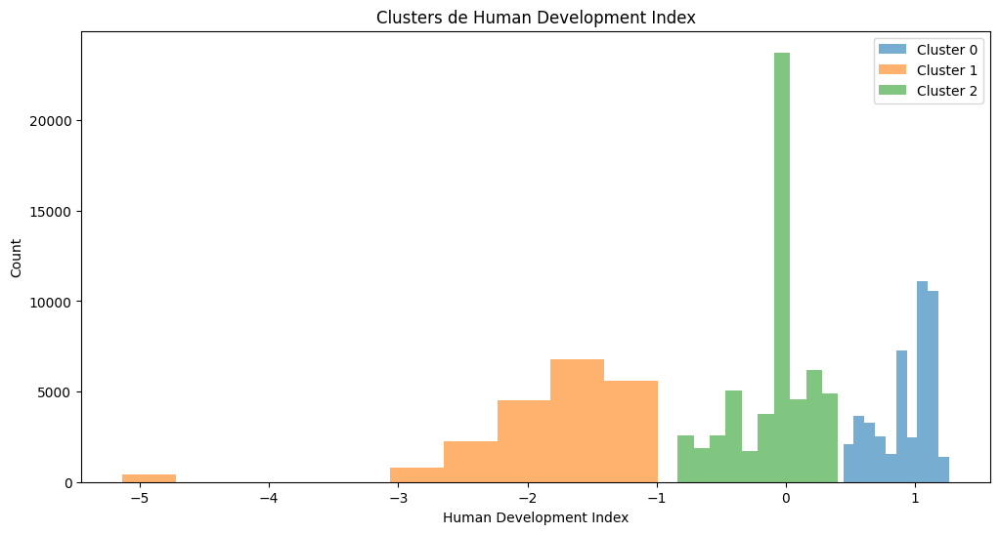

In [32]:
import matplotlib.pyplot as plt

# Crea una nueva figura
plt.figure(figsize=(12, 6))

# Genera un histograma de 'Human_Development_Index', con diferentes colores para cada cluster
for i in range(3):
    plt.hist(df_encoded[df_encoded['Human_Development_Index_cluster'] == i]['Human_Development_Index'], alpha=0.6, label=f'Cluster {i}')

# Añade un título y etiquetas a los ejes
plt.title('Clusters de Human Development Index')
plt.xlabel('Human Development Index')
plt.ylabel('Count')

# Muestra la leyenda
plt.legend()

# Muestra la gráfica
plt.show()